# Molniya Orbit

Orbital perturbations due to two different sources are considered:
1) Non-sphericity of the Earth
2) Drag force

The equation of motions after considering the orbital perturbations:

$ \ddot{x} = -\frac{\mu}{r^3}x + \frac{\mu x}{r^6}(J r^2 (5s-1)) + \frac{C_{D}A}{2m}(\dot{x}^2 + \dot{y}^2+\dot{z}^2)\dot{x} $ 
<br>
$ \ddot{y} = -\frac{\mu}{r^3}x + \frac{\mu x}{r^6}(J r^2 (5s-1)) + \frac{C_{D}A}{2m}(\dot{x}^2 + \dot{y}^2+\dot{z}^2)\dot{y} $ 
<br>
$ \ddot{z} = -\frac{\mu}{r^3}x + \frac{\mu x}{r^6}(J r^2 (5s-1)) + \frac{C_{D}A}{2m}(\dot{x}^2 + \dot{y}^2+\dot{z}^2)\dot{z} $ 

Where $ z = (z/r)^2 $

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML
from matplotlib.animation import FuncAnimation



In [54]:
class Integrator:
    def __init__(self, method='verlet', dt=dt, N=N):
        self.method = method
        self.dt = dt
        self.N = N
        self.x = np.zeros(N)   # array to store the x positions
        self.y = np.zeros(N)   # array to store the y positions
        self.z = np.zeros(N)   # array to store the z positions

        self.vx = np.zeros(N)  # array to store the x velocities
        self.vy = np.zeros(N)  # array to store the y velocities 
        self.vz = np.zeros(N)  # array to store the z velocities 
    
    def set_initial_conditions(self, x0, y0, z0, vx0, vy0, vz0):
        self.x[0] = x0
        self.y[0] = y0
        self.z[0] = z0

        self.vx[0] = vx0
        self.vy[0] = vy0
        self.vz[0] = vz0
    
    def accelerations(self, x, y, z, vx, vy, vz):
        
        Cd, A, m = 2.3, 0.158e6, 0.116e5
        J, H, K = 0.162e-2, -0.64e-5, 0.69e-5  # 2nd,3rd and 4th harmoinc coefficients of the Earth's gravitational potential

        r3_inv = ((x**2 + y**2 + z**2)**1.5)
        s = (z/r3_inv)**2
        
        k_term = K*(-63*s**2+42*s-3)/6

        ax = -x/r3_inv**3 + x*z**2*(J*(5*s-1)*r**2+ H*z*(7*s-3)+k_term)/r3_inv**6 + Cd*A*(vx**2 + vy**2 + vz**2) * vx/(2*m)
        ay = -y/r3_inv**3 + y*z**2*(J*(5*s-1)*r**2+ H*z*(7*s-3)+k_term)/r3_inv**6 + Cd*A*(vx**2 + vy**2 + vz**2) * vy/(2*m)
        az = -z/r3_inv**3 + z*z**2*(J*(5*s-1)*r**2+k_term)/r3_inv**6 + Cd*A*(vx**2 + vy**2 + vz**2) * vz/(2*m)
        az = az + H*(35*s**2- 30*s+3)/(5*r3_inv**5)
        return ax, ay, az
    
    def integrate(self):

        if self.method == 'heun':
            self.heun_integration()
        elif self.method == 'symplectic_euler':
            self.symplectic_euler_integration()
        else:
            raise ValueError("Unsupported integration method.")
    
    def symplectic_euler_integration(self):
        for i in range(self.N-1):
            ax, ay, az = self.accelerations(self.x[i], self.y[i], self.z[i], self.vx[i], self.vy[i], self.vz[i])
            self.vx[i+1] = self.vx[i] + ax*self.dt
            self.vy[i+1] = self.vy[i] + ay*self.dt
            self.vz[i+1] = self.vz[i] + az*self.dt

            self.x[i+1] = self.x[i] + self.vx[i+1]*self.dt
            self.y[i+1] = self.y[i] + self.vy[i+1]*self.dt
            self.z[i+1] = self.z[i] + self.vz[i+1]*self.dt

    def heun_integration(self):
        for i in range(self.N-1):
            ax, ay, az = self.accelerations(self.x[i], self.y[i],self.z[i], self.vx[i], self.vy[i], self.vz[i])
            x_predictor = self.x[i] + self.vx[i]*self.dt
            y_predictor = self.y[i] + self.vy[i]*self.dt
            z_predictor = self.z[i] + self.vz[i]*self.dt

            ax_pred, ay_pred, az_pred = self.accelerations(x_predictor, y_predictor, z_predictor, self.vx[i], self.vy[i], self.vz[i])
            self.vx[i+1] = self.vx[i] + 0.5*(ax + ax_pred)*self.dt
            self.vy[i+1] = self.vy[i] + 0.5*(ay + ay_pred)*self.dt
            self.vz[i+1] = self.vz[i] + 0.5*(az + az_pred)*self.dt

            self.x[i+1] = self.x[i] + 0.5*(self.vx[i] + self.vx[i+1])*self.dt
            self.y[i+1] = self.y[i] + 0.5*(self.vy[i] + self.vy[i+1])*self.dt
            self.z[i+1] = self.z[i] + 0.5*(self.vz[i] + self.vz[i+1])*self.dt
    

    # Return the phase space coordinates
    def position_space(self):

        return self.x, self.y, self.z
    

    def plot_trajectory(self):

        fig, axs = plt.subplots(2, 3, figsize=(18, 12))  # Adjust for 2 rows and 3 columns

        # x vs. y plot for trajectory
        axs[0, 0].plot(self.x, self.y, color='darkorange')
        axs[0, 0].set_title(f'Orbit using {self.method.capitalize()} Integration')
        axs[0, 0].set_xlabel('x')
        axs[0, 0].set_ylabel('y')
        axs[0, 0].axis('equal')  # Ensuring aspect ratio is equal to see circular path clearly
        axs[0, 0].grid(True)
        

        # Plot for x position
        axs[0, 1].plot(t, self.x, color='blue')
        axs[0, 1].set_title('Position x(t)')
        axs[0, 1].set_xlabel('Time')
        axs[0, 1].set_ylabel('x')
        axs[0, 1].grid(True)
       

        # Plot for x velocity
        axs[0, 2].plot(t, self.vx, color='green')
        axs[0, 2].set_title('Velocity x\'(t)')
        axs[0, 2].set_xlabel('Time')
        axs[0, 2].set_ylabel(r'$V_{x}$')
        axs[0, 2].grid(True)
     

        # Plot for y position
        axs[1, 0].plot(self.vy, self.y, color='black')
        axs[1, 0].set_title('y-Py')
        axs[1, 0].set_xlabel('Py')
        axs[1, 0].set_ylabel('y')
        axs[1, 0].grid(True)
        


        # Plot for y position
        axs[1, 1].plot(t, self.y, color='red')
        axs[1, 1].set_title('Position y(t)')
        axs[1, 1].set_xlabel('Time')
        axs[1, 1].set_ylabel('Position y')
        axs[1, 1].grid(True)
        

        # Plot for y velocity
        axs[1, 2].plot(t, self.vy, color='purple')
        axs[1, 2].set_title('Velocity y\'(t)')
        axs[1, 2].set_xlabel('Time')
        axs[1, 2].set_ylabel('Velocity y\'')
        axs[1, 2].grid(True)
        

        plt.tight_layout()
        plt.show()
    
    # Function to animate the trajectory (x an y corrdinates)
    def animate_trajectory(self):
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')

        not_nan_inf_1 = ~np.isnan(self.x) & ~np.isinf(self.y) & ~np.isinf(self.z)
        self.x = self.x[not_nan_inf_1]
        self.y = self.y[not_nan_inf_1]
        self.z = self.z[not_nan_inf_1]

        ax.set_title(f'Orbit using {self.method.capitalize()} Integration')
        ax.set_xlim((np.min(self.x)-1, np.max(self.x)+1))
        ax.set_ylim((np.min(self.y)-1, np.max(self.y)+1))
        ax.set_zlim((np.min(self.z)-1, np.max(self.z)+1))

        ax.set_xlabel('x')
        ax.set_ylabel('y')
        ax.set_zlabel('z')

        line, = ax.plot([], [], [], lw=2)
        
        def init():
            line.set_data([], [])
            line.set_3d_properties([])
            return line,
        
        def update(frame):
            line.set_data(self.x[:frame], self.y[:frame])
            line.set_3d_properties(self.z[:frame])
            return line,
        
        ani = FuncAnimation(fig, update, frames=range(1, self.N, 100),
                            init_func=init, blit=False, interval=20)
        plt.close(fig)
        return ani




In [47]:
array1 = np.array([1, np.nan, 3, np.inf, 5])
array2 = np.array([1, 2, np.nan, 4, np.inf])
array3 = np.array([np.inf, 2, 3, 4, 5])

# Find where elements are not NaN and not Inf in all arrays
not_nan_inf_1 = ~np.isnan(array1) & ~np.isinf(array1) & ~np.isinf(array3)
not_nan_inf_1

array([False, False,  True, False,  True])

# Initial Conditions

In [52]:
sma, ecc, incl, arg, raan, ta = 26552, 0.7099, np.deg2rad(63.45), np.deg2rad(282.7), 250.7, np.deg2rad(0.0)

# Position vectors in terms of Keplarian orbital elements
r = sma*(1-ecc**2)/(1+ecc*np.cos(ta))
x0 = r*(np.cos(raan)*np.cos(arg+ta) - np.sin(raan)*np.sin(arg+ta)*np.cos(incl))
y0 = r*(np.sin(raan)*np.cos(arg+ta) + np.cos(raan)*np.sin(arg+ta)*np.cos(incl))
z0 = r*(np.sin(arg+ta)*np.sin(incl))



100000


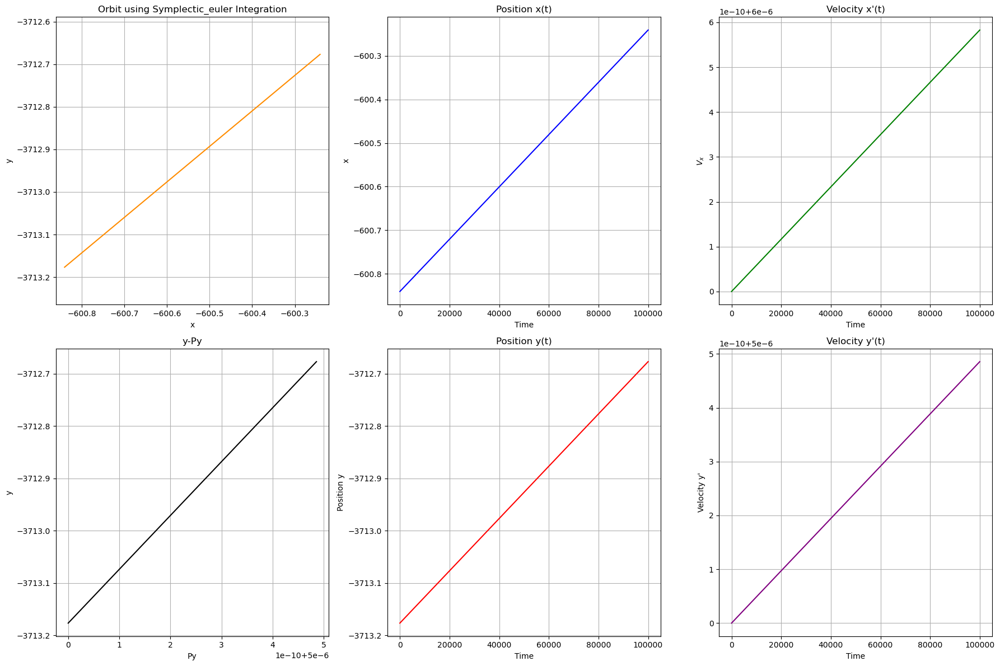

Animation size has reached 21047835 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [90]:
vx0 = 0.6e-5  # Initial x velocity
vy0 = 0.5e-5   # Initial y velocity
vz0 = 0.1e-5   # Initial z velocity

t = np.linspace(0, 100000.0, 100000)
dt = t[1]-t[0] # Time step
N = t.size  # Number of steps

integrator = Integrator(method='symplectic_euler', dt=dt, N=N)
integrator.set_initial_conditions(x0=x0, y0=y0, z0=z0, vx0=vx0, vy0=vy0, vz0 = vz0)
integrator.integrate()

x_ar, y_ar, z_ar = integrator.position_space()

print(z_ar[~np.isnan(z_ar)].size) # to check how many overflows are there in the z array
integrator.plot_trajectory()

anime = integrator.animate_trajectory()

# To display the animation in a Jupyter notebook
HTML(anime.to_jshtml())

In [72]:
x0, y0, z0

(-600.8406745700479, -3713.1767622117172, -6721.862716366065)

In [89]:
z_ar[~np.isnan(z_ar)].size

100000